In [1]:
import pandas as pd
import numpy as np
import json

import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# %pip install folium
# %pip install geopy

import folium
from folium.features import DivIcon
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster, FeatureGroupSubGroup

from tqdm import tqdm
import geopy.distance

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
df_ny = pd.read_csv("./AB_NYC_2019.csv")
df_ny.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
# Get Map with the necessary features
map_df = df_ny[['neighbourhood_group','latitude','longitude','price']]

# Create a base map
city_map = folium.Map(location=[40.64749,-73.97237],zoom_start=11.2)

# Initialize markercluster
mc = MarkerCluster(control=False)
city_map.add_child(mc)

# Initialize subgroups

# Add group 1
g1 = FeatureGroupSubGroup(mc,'Manhattan')
city_map.add_child(g1)

# Add group 2
g2 = FeatureGroupSubGroup(mc,'Queens')
city_map.add_child(g2)

# Add group 3
g3 = FeatureGroupSubGroup(mc,'Bronx')
city_map.add_child(g3)

# Add group 4
g4 = FeatureGroupSubGroup(mc,'Staten Island')
city_map.add_child(g4)

# Add group 5
g5 = FeatureGroupSubGroup(mc,'Brooklyn')
city_map.add_child(g5)

# Create dataframe w.r.t neighbourhood
df1 = df_ny[df_ny['neighbourhood_group']=="Manhattan"]
df2 = df_ny[df_ny['neighbourhood_group']=="Queens"]
df3 = df_ny[df_ny['neighbourhood_group']=="Bronx"]
df4 = df_ny[df_ny['neighbourhood_group']=="Staten Island"]
df5 = df_ny[df_ny['neighbourhood_group']=="Brooklyn"]

# List of filtered dataframe and subgroup objects
df_list = [df1,df2,df3,df4,df5]
grp_list = [g1,g2,g3,g4,g5]
city_list = ["Manhattan HM Price","Queens HM Price","Bronx HM Price","Staten Island HM Price","Brooklyn HM Price"]
city_cos = [[40.797474,-73.980163],[40.733507, -73.851074],[40.8448,-73.8648],[40.5795,-74.1502],
            [40.643433,-74.000076]]

# Add marker to each city
for city_index,city_co in enumerate(city_cos):
    html = f"""<div style="font-size:35pt">{city_list[city_index].split()[0]}</div>"""
    city_map.add_child(Marker(city_co,icon=DivIcon(html=html)))

# For each filtered df
for df_idx,map_df in enumerate(df_list):   
    
    if True:
        city_map.add_child(HeatMap(map_df[['latitude','longitude','price']],city_list[df_idx]))
    # Add a marker to the respective group
    for idx,row in tqdm(map_df.iterrows()):
        msg = """
        Neighbourhood Grp: <b>%s</b><br>
        Price: <b>%s</b><br>
        """ %(row['neighbourhood_group'],row['price'])
        Marker([row['latitude'],row['longitude']],tooltip=msg).add_to(grp_list[df_idx])
        
l = folium.LayerControl().add_to(city_map)
city_map

21661it [00:01, 19106.95it/s]
5666it [00:00, 17002.92it/s]
1091it [00:00, 20143.62it/s]
373it [00:00, 20664.60it/s]
20104it [00:01, 18553.52it/s]


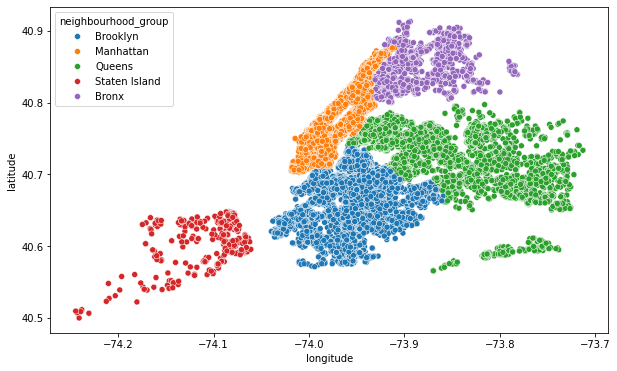

In [10]:
plt.figure(figsize=(10,6))
sns.scatterplot(x = df_ny.longitude, y = df_ny.latitude, hue=df_ny.neighbourhood_group)
plt.ioff()

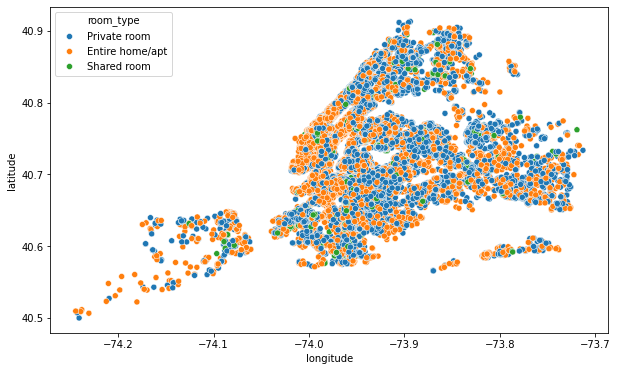

In [11]:
plt.figure(figsize=(10,6))
sns.scatterplot(x = df_ny.longitude, y = df_ny.latitude, hue=df_ny.room_type)
plt.ioff()

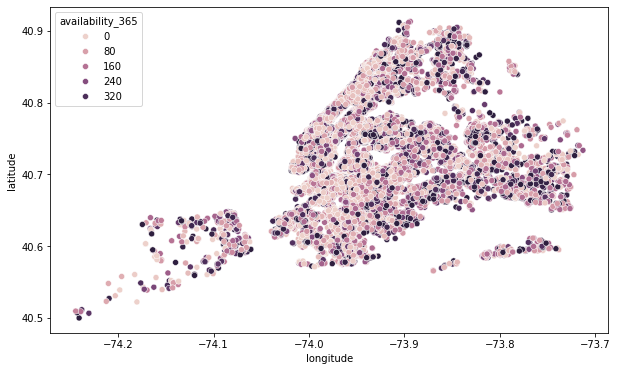

In [12]:
plt.figure(figsize=(10,6))
sns.scatterplot(x = df_ny.longitude, y = df_ny.latitude, hue=df_ny.availability_365)
plt.ioff()

## Room Type¶

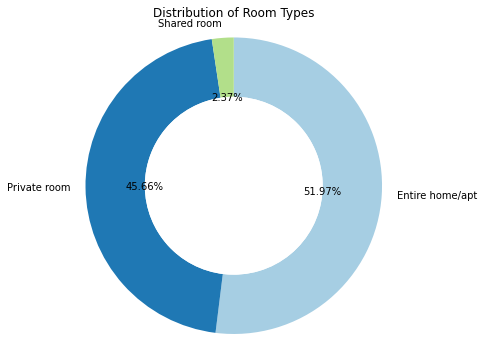

In [4]:
room_type = df_ny["room_type"].value_counts()
labels = room_type.index
values = room_type.values

# Set up a color palette for the pie chart
colors = plt.cm.Paired(range(len(labels)))

plt.figure(figsize=(8, 6))
plt.pie(values, labels=labels, autopct='%1.2f%%', colors=colors, startangle=90, counterclock=False, 
        wedgeprops=dict(width=0.4))

# Draw a circle at the center to make it look like a donut chart
centre_circle = plt.Circle((0, 0), 0.6, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle.
plt.axis('equal')  
plt.title("Distribution of Room Types")
plt.show()

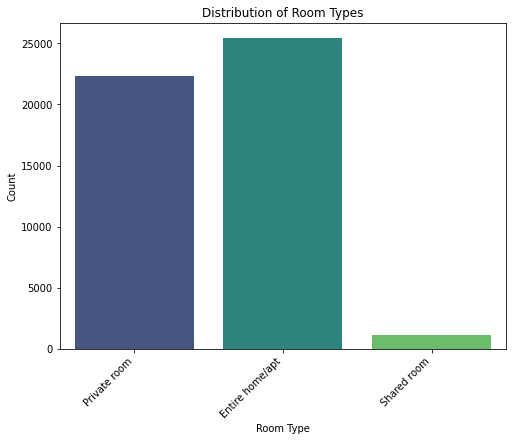

In [5]:
plt.figure(figsize=(8, 6))

# Use Seaborn's countplot with hue and legend parameters
sns.countplot(data=df_ny, x="room_type", hue="room_type", palette="viridis", legend=False)

# Add labels and title
plt.xlabel("Room Type")
plt.ylabel("Count")
plt.title("Distribution of Room Types")

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')
plt.show()

## NeighbourHood

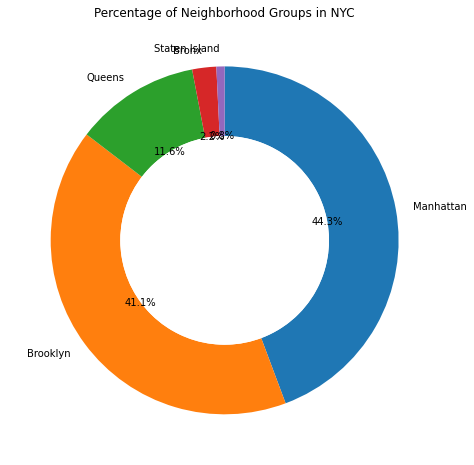

In [6]:
# Pie chart
neighbourhood_type = df_ny["neighbourhood_group"].value_counts()
values = neighbourhood_type.values
labels = neighbourhood_type.index

plt.figure(figsize=(12, 8))
plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=90, counterclock=False, wedgeprops=dict(width=0.4))

# Draw a circle at the center to make it look like a donut chart
centre_circle = plt.Circle((0, 0), 0.6, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title("Percentage of Neighborhood Groups in NYC")
plt.show()

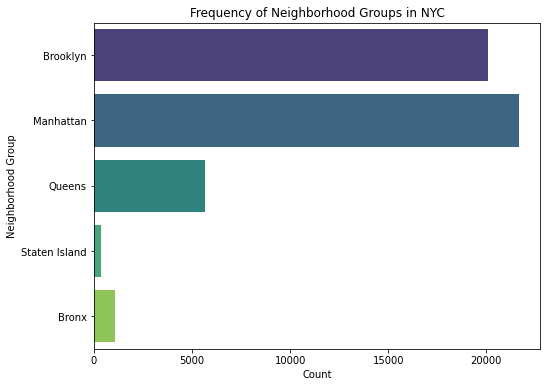

In [7]:
# Countplot
plt.figure(figsize=(8, 6))
sns.countplot(data=df_ny, y="neighbourhood_group", palette="viridis", hue="neighbourhood_group", legend=False)

plt.title("Frequency of Neighborhood Groups in NYC")
plt.xlabel("Count")
plt.ylabel("Neighborhood Group")
plt.show()

## Price Distribution

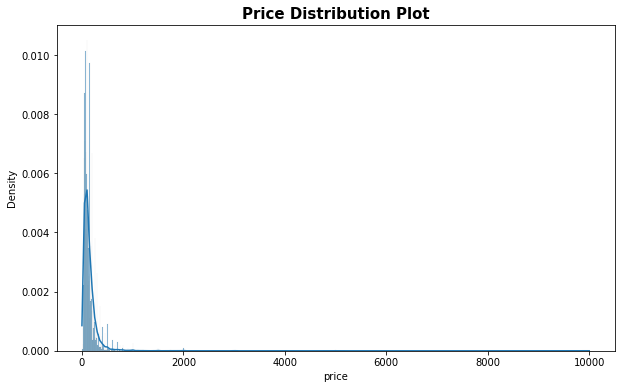

In [8]:
plt.figure(figsize=(10, 6))
sns.histplot(df_ny['price'], kde=True, stat='density', common_norm=False)
plt.title("Price Distribution Plot", size=15, weight='bold')
plt.show()

## Correlation Matrix

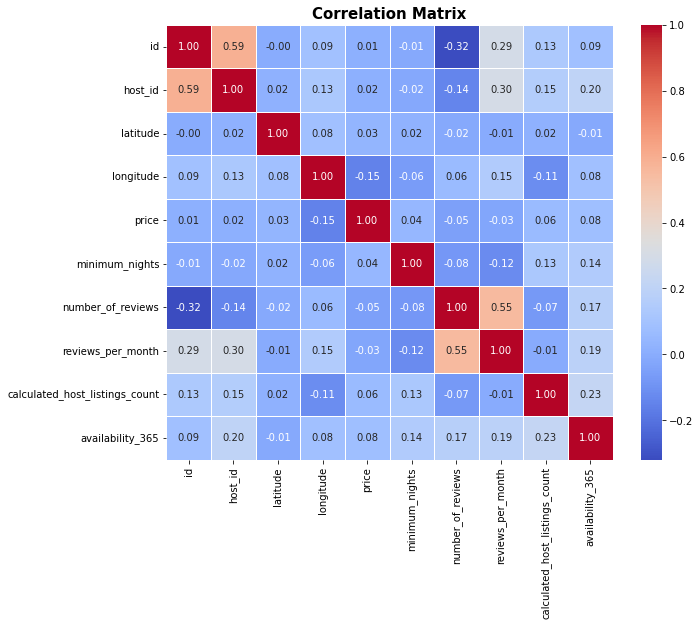

In [9]:
# Assuming df_ny is your DataFrame
correlation_matrix = df_ny.corr()

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))

# Draw the correlation matrix heatmap
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)

# Add a title
plt.title("Correlation Matrix", size=15, weight='bold')

# Show the plot
plt.show()